In [1]:
!python --version

Python 3.6.9


In [2]:
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Wed_Jul_22_19:09:09_PDT_2020
Cuda compilation tools, release 11.0, V11.0.221
Build cuda_11.0_bu.TC445_37.28845127_0


In [3]:
!pip install megengine==0.3.1 -f https://megengine.org.cn/whl/mge.html

Looking in links: https://megengine.org.cn/whl/mge.html


In [4]:
!pip freeze | grep MegEngine

MegEngine==0.3.1


Compiling gpu_nms library

In [5]:
%cd CrowdDetection/lib/layers

#Здесь нужно указать свой путь к этой библиотеке
!echo 'nvcc -I ~/../usr/local/lib/python3.6/dist-packages/megengine/_internal/include -shared -o lib_nms.so -Xcompiler "-fno-strict-aliasing -fPIC" ./gpu_nms/nms.cu' > setup.sh
!sh ./setup.sh

/tf/notebooks/tkachenko_detection/CrowdDetection/lib/layers


Let's check if we can run model in inference mode

In [6]:
%cd ../../..

/tf/notebooks/tkachenko_detection


In [7]:
!python CrowdDetection/model/emd_simple/inference.py -r meg_emd_simple.pkl -i test.jpg

In [20]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import os
import random
import json
from CrowdDetection.model.emd_simple.config import Config

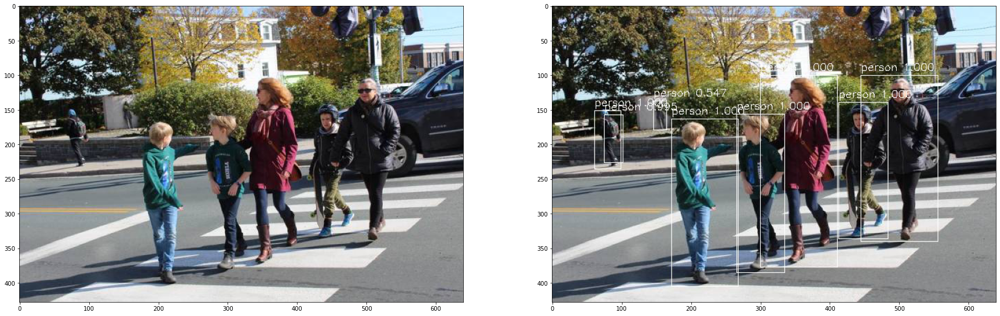

In [9]:
original_image_path = 'test.jpg'
result_image_path = 'CrowdDetection/model/emd_simple/result.jpg'

fig, axes = plt.subplots(1, 2, figsize=(30, 15))

axes[0].imshow(Image.open(original_image_path))
axes[1].imshow(Image.open(result_image_path))

plt.show()

As we see, the model works correctly

**Masking script testing**

Example of call: python CrowdDetection/model/emd_simple/masking_script.py -w -s -d -t -c<br>
-w: path to model's weights<br>
-s: path to the source image folder<br>
-d: path where the folder with results will be created<br>
Optional:<br>
-t: threshold for keeping bounding boxes with higher score (Default: 0.3)<br>
-c: pixel value for filling bounding boxes (Default: 0)

UAV dataset

In [10]:
!python CrowdDetection/model/emd_simple/masking_script.py -w meg_emd_simple.pkl -s datasets/uav_dataset -d . -t 0.85

In [11]:
original_images_folder_path = 'datasets/uav_dataset'
masked_images_folder_path = 'uav_dataset_outputs'

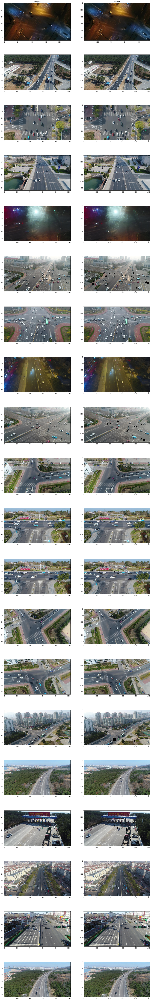

In [12]:
n_pairs = 20

fig, axes = plt.subplots(n_pairs, 2, figsize=(20, n_pairs * 7))
axes[0, 0].set_title('Original')
axes[0, 1].set_title('Masked')

for i, image_name in enumerate(random.sample(os.listdir(original_images_folder_path), n_pairs)):
    axes[i, 0].imshow(Image.open(os.path.join(original_images_folder_path, image_name)))
    axes[i, 1].imshow(Image.open(os.path.join(masked_images_folder_path, image_name)))

plt.show()

Night dataset (here white filling is used for easier masks spotting)

In [13]:
!python CrowdDetection/model/emd_simple/masking_script.py -w meg_emd_simple.pkl -s datasets/night_road_part_dataset -d . -t 0.85 -c 255

In [14]:
original_images_folder_path = 'datasets/night_road_part_dataset'
masked_images_folder_path = 'night_road_part_dataset_outputs'

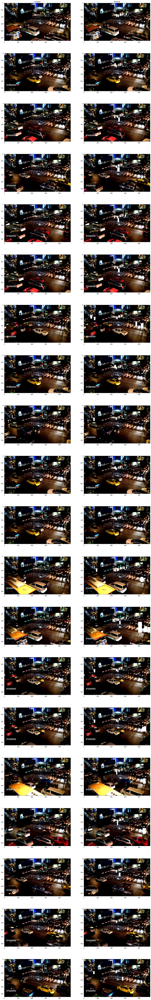

In [15]:
n_pairs = 20

fig, axes = plt.subplots(n_pairs, 2, figsize=(20, n_pairs * 7))
axes[0, 0].set_title('Original')
axes[0, 1].set_title('Masked')

for i, image_name in enumerate(random.sample(os.listdir(original_images_folder_path), n_pairs)):
    axes[i, 0].imshow(Image.open(os.path.join(original_images_folder_path, image_name)))
    axes[i, 1].imshow(Image.open(os.path.join(masked_images_folder_path, image_name)))

plt.show()

**Trying to train the network**

In [16]:
# Модель можно попытаться файнтюнить, я починил скрипт для тренировки. По какой то причине вылезает ошибка, если
# для изображения есть только один bounding box в аннотации. Поэтому нужно брать только те, для которых есть >=2.

# !python CrowdDetection/model/emd_simple/train.py -r meg_emd_simple.pkl

**Testing the network**

In [23]:
# Номер эпохи, сохраненные веса после которой нужно взять для теста. 100 - оригинальные веса модели. Если захочешь
# взять другой датасет для теста/тренировки, путь к нему нужно будет прописать в model/emd_simple/config.py

epoch_file = 100

In [18]:
%cd CrowdDetection/model/emd_simple
!python test.py -r $epoch_file

/tf/notebooks/tkachenko_detection/CrowdDetection/model/emd_simple
Weights were successfully loaded.
Data was successfully loaded.
100%|███████████| 243/243 [00:23<00:00, 10.28it/s]


**Visualizing result of the test**

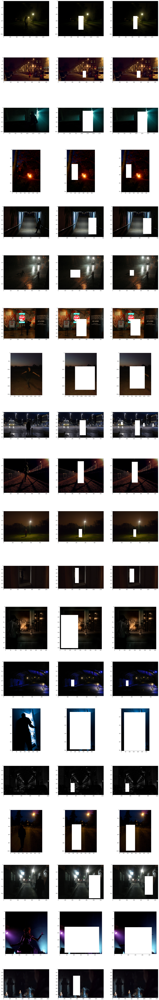

In [21]:
n_pairs = 20

fig, axes = plt.subplots(n_pairs, 3, figsize=(30, 10 * n_pairs))

with open(f'outputs/eval_dump/dump-{epoch_file}.json') as file:
    for i, line in enumerate(file.readlines()[:n_pairs]):
        current_json = json.loads(line)
        for image_name in os.listdir(os.path.join(Config.image_folder)):
            if image_name.startswith(current_json['ID']):
                image = np.array(Image.open(os.path.join(Config.image_folder, image_name)))
                break
                
        original_masked_image = image.copy()
        for box in current_json['gtboxes']:
            x, y, width, height = map(int, box['box'])
            original_masked_image[y:y+height, x:x+width] = 255
            
        predicted_masked_image = image.copy()
        for box in current_json['dtboxes']:
            x, y, width, height = map(int, box['box'])
            predicted_masked_image[y:y+height, x:x+width] = 255
        
        axes[i, 0].imshow(image)
        axes[i, 1].imshow(original_masked_image)
        axes[i, 2].imshow(predicted_masked_image)